# DL4M Final Model - Sound Generator

**Ploy and Anika's Sound Generator Edited Model**

This model is an edited version of the original Dance Diffusion model that can be found [here.](https://colab.research.google.com/github/Harmonai-org/sample-generator/blob/main/Dance_Diffusion.ipynb)

**Audio diffusion tools in this notebook**:

- Audio sample regeneration/style transfer using a single audio file or recording
- Audio interpolation between two audio files

# Instructions



## Before anything else
- Run the "Setup" section
- Sign in to the Google Drive account you want to save your models in
- Select the model you want to sample from in the "Model settings" section, this determines the length and sound of your samples
- Select the sampler you want to use.

## To regenerate your own sounds
- You can either record a file, enter the path to an audio file you want to regenerate, or upload a file when prompted
- Make sure the "skip_for_run_all" checkbox is unchecked
- Run the cell under the "Regenerate your own sounds" header

## To interpolate between two different sounds
- Enter the paths to two audio files you want to interpolate between, or upload them when prompted
- Make sure the "skip_for_run_all" checkbox is unchecked
- Run the cell under the "Interpolate between sounds" header


### Credits & License

Edited and commented by Ploy and Anika.

Original notebook by Zach Evans (https://github.com/zqevans, https://twitter.com/zqevans). 

Overall structure and setup code taken from Disco Diffusion (https://www.discodiffusion.com)

Interpolation and audio display code from CRASH inference notebook (https://github.com/simonrouard/CRASH)

Spruced up by Chris the Wizard (https://twitter.com/chris_wizard)

Audio recording widget added by Niels Bantilan (https://twitter.com/cosmicBboy)


Licensed under the MIT License

Copyright (c) 2022 Zach Evans

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in
all copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN
THE SOFTWARE.


In [1]:
#@title <- View Changelog
skip_for_run_all = True #@param {type: 'boolean'}


if skip_for_run_all == False:
  print(
      '''

  v0.1 Update: Jul 30, 2022 - zqevans
      
      - Added Dance Diffusion notebook

  v0.2 Update: Aug 8, 2022 - zqevans

      - Moved to models trained on 

  v0.3 Update: Aug 11, 2022 - zqevans

      - Reverted to old model architecture
      - Fixed CRASH sampling code

  v0.4 Update: Aug 16, 2022 - zqevans

      - Added jmann-small-190k model

  v0.5 Update: Aug 17, 2022 - zqevans

      - Added interpolations
    
  v0.6 Update: Aug 18, 2022 - zqevans

      - Fixed bug in interpolations

  v0.7 Update: Aug 20, 2022 - zqevans
      - Added maestro-150k model
      - Added unlocked-250k model
      - Improved documentation

  v0.7.1 Update: Aug 21, 2022 - chris the wizard
      - Added introduction
      - Added instructions
      - Added skips for sections
      - Added upload prompts for audio files
      - Removed stale demos

  v0.8 Update: Aug 24, 2022 - zqevans
      - Added Honk model
      - Removed Rave Archive model
      - Added sample length multipliers and batch sizes to regeneration and interpolation

  v0.9 Update: Aug 24, 2022 - zqevans
      - Added glitch.cool model
      - Added jmann-large model
      - Regenerated sounds are now output individually
      - Added custom model sample_size and sample_rate options

  v0.10 Update: Sep 26, 2022 - morganmcg1
      - Added optional, off by default, Weights & Biases logging of the generated audio samples

  v0.11 Update: Oct 27, 2022 - cosmicBboy
      - Added a gradio audio recording widget in the "Regenerate your own sounds" section
      
  v0.12 Update: Nov 3, 2022 - zqevans
      - Added k-diffusion samplers
      - Added option to increase unconditional generation length
    '''
  )

# Install dependencies and restart notebook

**The session will crash to restart automatically, don't worry about the error. This is to ensure the proper dependencies are installed.**

**Once the notebook restarts, continue with the steps below.**

In [ ]:
from IPython.display import clear_output  
import os, signal

#@title Install and restart

#@markdown 

!git clone https://github.com/harmonai-org/sample-generator
!git clone --recursive https://github.com/crowsonkb/v-diffusion-pytorch
!pip install /content/sample-generator
!pip install /content/v-diffusion-pytorch
!pip install ipywidgets==7.7.1 gradio
!pip install k-diffusion

os.kill(os.getpid(), signal.SIGKILL)

fatal: destination path 'sample-generator' already exists and is not an empty directory.
fatal: destination path 'v-diffusion-pytorch' already exists and is not an empty directory.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing ./sample-generator
  Preparing metadata (setup.py) ... done
  Using cached argparse-1.4.0-py2.py3-none-any.whl (23 kB)
  Created wheel for sample-generator: filename=sample_generator-1.0.0-py3-none-any.whl size=9852 sha256=d31236e00ebc63b7cccb4fb83b6d988a51d6e117a9b7912c3752cfca5e5dbe85
  Stored in directory: /root/.cache/pip/wheels/bc/41/05/b033dc5f7ec28e8a1ee27215d8fc84a37bf5d953f1f347872f
Successfully built sample-generator
  Attempting uninstall: sample-generator
    Found existing installation: sample-generator 1.0.0
    Uninstalling sample-generator-1.0.0:
      Successfully uninstalled sample-generator-1.0.0


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing ./v-diffusion-pytorch
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for v-diffusion-pytorch: filename=v_diffusion_pytorch-0.0.2-py3-none-any.whl size=20526 sha256=7ada9ec05fe497bb6d18fbd4f0ecf7082709aea3655a6d002e342c97675c6232
  Stored in directory: /root/.cache/pip/wheels/3f/ae/b5/ece2386f65499c04fd4cfb88ac34daf9a0b6d269712fb995cf
Successfully built v-diffusion-pytorch
  Attempting uninstall: v-diffusion-pytorch
    Found existing installation: v-diffusion-pytorch 0.0.2
    Uninstalling v-diffusion-pytorch-0.0.2:
      Successfully uninstalled v-diffusion-pytorch-0.0.2
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pk

# Setup
Run everything in this section before any generation

In [1]:
#this checks the GPU status to inform the user which GPU they are using

import subprocess
simple_nvidia_smi_display = True#@param {type:"boolean"}
if simple_nvidia_smi_display:
    #!nvidia-smi
    nvidiasmi_output = subprocess.run(['nvidia-smi', '-L'], stdout=subprocess.PIPE).stdout.decode('utf-8')
    print(nvidiasmi_output)
else:
    #!nvidia-smi -i 0 -e 0
    nvidiasmi_output = subprocess.run(['nvidia-smi'], stdout=subprocess.PIPE).stdout.decode('utf-8')
    print(nvidiasmi_output)
    nvidiasmi_ecc_note = subprocess.run(['nvidia-smi', '-i', '0', '-e', '0'], stdout=subprocess.PIPE).stdout.decode('utf-8')
    print(nvidiasmi_ecc_note)

GPU 0: Tesla T4 (UUID: GPU-90dae6aa-4247-5902-3658-22c7e7aa7609)



In [2]:
#@title Prepare folders

#this code connects to the google drive and provides a very basic GUI for the user to save generate audio and save the models to a specific place
import subprocess, os, sys, ipykernel


#allows the user to clone the git repo
def gitclone(url, targetdir=None):
    if targetdir:
        res = subprocess.run(['git', 'clone', url, targetdir], stdout=subprocess.PIPE).stdout.decode('utf-8')
    else:
        res = subprocess.run(['git', 'clone', url], stdout=subprocess.PIPE).stdout.decode('utf-8')
    print(res)

def pipi(modulestr):
    res = subprocess.run(['pip', 'install', modulestr], stdout=subprocess.PIPE).stdout.decode('utf-8')
    print(res)

def pipie(modulestr):
    res = subprocess.run(['git', 'install', '-e', modulestr], stdout=subprocess.PIPE).stdout.decode('utf-8')
    print(res)

def wget(url, outputdir):
    # Using the !wget command instead of the subprocess to get the loading bar
    !wget $url -O $outputdir
    # res = subprocess.run(['wget', url, '-P', f'{outputdir}'], stdout=subprocess.PIPE).stdout.decode('utf-8')
    # print(res)

try:
    from google.colab import drive
    print("Google Colab detected.")
    is_colab = True
    #@markdown Check to connect your Google Drive
    google_drive = True #@param {type:"boolean"}
    if google_drive:
      print("Using Google Drive.")
    #@markdown Click here if you'd like to save the diffusion model checkpoint file to (and/or load from) your Google Drive:
    save_models_to_google_drive = True #@param {type:"boolean"}
except:
    is_colab = False
    google_drive = False
    save_models_to_google_drive = False
    print("Google Colab not detected.")

if is_colab:
    if google_drive is True:
        drive.mount('/content/drive')
        ai_root = '/content/drive/MyDrive/AI'
        root_path = f'{ai_root}/Dance_Diffusion'
    else:
        root_path = '/content'
else:
    root_path = os.getcwd()

import os
def createPath(filepath):
    os.makedirs(filepath, exist_ok=True)

initDirPath = f'{root_path}/init_audio'
createPath(initDirPath)
outDirPath = f'{root_path}/audio_out'
createPath(outDirPath)

if is_colab:
    if google_drive and not save_models_to_google_drive or not google_drive:
        model_path = '/content/models'
        createPath(model_path)
    if google_drive and save_models_to_google_drive:
        model_path = f'{ai_root}/models'
        createPath(model_path)
else:
    model_path = f'{root_path}/models'
    createPath(model_path)

Google Colab detected.
Using Google Drive.
Mounted at /content/drive


In [4]:
#@title Imports and definitions
#this code snippet imports and defines all required libraries for the model and interpolation to run

from prefigure.prefigure import get_all_args
from contextlib import contextmanager
from copy import deepcopy
import math
from pathlib import Path
from google.colab import files

import os, signal, sys
import gc

from diffusion import sampling
import torch
from torch import optim, nn
from torch.nn import functional as F
from torch.utils import data
from tqdm import trange
from einops import rearrange

import torchaudio
from audio_diffusion.models import DiffusionAttnUnet1D
import numpy as np

import random
import matplotlib.pyplot as plt
import IPython.display as ipd
from audio_diffusion.utils import Stereo, PadCrop
from glob import glob

#@title Model code

#creates a class to hold/create the model
class DiffusionUncond(nn.Module):
    def __init__(self, global_args):
        super().__init__()

        #creates the model
        self.diffusion = DiffusionAttnUnet1D(global_args, n_attn_layers = 4)
        self.diffusion_ema = deepcopy(self.diffusion)
        self.rng = torch.quasirandom.SobolEngine(1, scramble=True)

import matplotlib.pyplot as plt
import IPython.display as ipd

def plot_and_hear(audio, sr):
    '''
      plots the audio and displays it using a given audio file and sample rate
      ------
      Paramters:
        audio: tensor
          the file path to the audio
        sr: int
          the sample rate of the audio
    '''
    #displays/plots the audio and the sample rate (audio wavelength on x axis, sample rate on y axis)
    display(ipd.Audio(audio.cpu().clamp(-1, 1), rate=sr))

    #plots the audio in a graph using numpy
    plt.plot(audio.cpu().t().numpy())
  
def load_to_device(path, sr):
    '''
      loads the audio file using the user given path
      ------
      Paramters:
        path: str
          the file path to the audio
        sr: int
          the sample rate of the audio
    '''
    audio, file_sr = torchaudio.load(path)
    if sr != file_sr:
      #resampling the audio if the sample rates don't match up
      audio = torchaudio.transforms.Resample(file_sr, sr)(audio)
    #converts the audio to tensor to save to either GPU or CPU, whatever the user is using
    audio = audio.to(device)
    return audio

def get_alphas_sigmas(t):
    #over time, this returns the scaling factor for clean image and for the noise values
    """Returns the scaling factors for the clean image (alpha) and for the
    noise (sigma), given a timestep."""
    return torch.cos(t * math.pi / 2), torch.sin(t * math.pi / 2)

def get_crash_schedule(t):
    sigma = torch.sin(t * math.pi / 2) ** 2
    alpha = (1 - sigma ** 2) ** 0.5
    return alpha_sigma_to_t(alpha, sigma)

def t_to_alpha_sigma(t):
    """Returns the scaling factors for the clean image and for the noise, given
    a timestep."""
    return torch.cos(t * math.pi / 2), torch.sin(t * math.pi / 2)

def alpha_sigma_to_t(alpha, sigma):
    """Returns a timestep, given the scaling factors for the clean image and for
    the noise."""
    return torch.atan2(sigma, alpha) / math.pi * 2

#@title Args
sample_size = 65536 
sample_rate = 48000   
latent_dim = 0             

class Object(object):
    pass

args = Object()
args.sample_size = sample_size
args.sample_rate = sample_rate
args.latent_dim = latent_dim

#@title Logging
def get_one_channel(audio_data, channel):
  '''
    gets one channel from the audio
    ------
    Paramters:
      audio_data: tensor
        the file path to the audio
      channel: int
        the channel of the audio
  '''
  #check if the audio has more than 1 channel
  if len(audio_data.shape) > 1:
    is_stereo = True      
    if np.argmax(audio_data.shape)==0:
        audio_data = audio_data[:,channel] 
    else:
        audio_data = audio_data[channel,:]
  else:
    is_stereo = False

  return audio_data

    

# Model settings

Select the model you want to sample from
---
Model name | Description | Sample rate | Output samples
--- | --- | --- | ---
glitch-440k |Trained on clips from samples provided by [glitch.cool](https://glitch.cool) | 48000 | 65536
jmann-small-190k |Trained on clips from Jonathan Mann's [Song-A-Day](https://songaday.world/) project | 48000 | 65536
jmann-large-580k |Trained on clips from Jonathan Mann's [Song-A-Day](https://songaday.world/) project | 48000 | 131072
maestro-150k |Trained on piano clips from the [MAESTRO](https://magenta.tensorflow.org/datasets/maestro) dataset | 16000 | 65536
unlocked-250k |Trained on clips from the [Unlocked Recordings](https://archive.org/details/unlockedrecordings) dataset | 16000 | 65536
honk-140k |Trained on recordings of the Canada Goose from [xeno-canto](https://xeno-canto.org/) | 16000 | 65536


In [5]:
from urllib.parse import urlparse
import hashlib
import k_diffusion as K

#@title Create the model
model_name = "glitch-440k" #@param ["glitch-440k", "jmann-small-190k", "jmann-large-580k", "maestro-150k", "unlocked-250k", "honk-140k", "custom"]

#@markdown ###Custom options

#@markdown If you have a custom fine-tuned model, choose "custom" above and enter a path to the model checkpoint here

#@markdown These options will not affect non-custom models
custom_ckpt_path = ''#@param {type: 'string'}

custom_sample_rate = 48000 #@param {type: 'number'}
custom_sample_size = 65536 #@param {type: 'number'}


#add links to different models to allow users to pick at runtime
models_map = {

    "glitch-440k": {'downloaded': False,
                         'sha': "48caefdcbb7b15e1a0b3d08587446936302535de74b0e05e0d61beba865ba00a", 
                         'uri_list': ["https://model-server.zqevans2.workers.dev/gwf-440k.ckpt"],
                         'sample_rate': 48000,
                         'sample_size': 65536
                         },
    "jmann-small-190k": {'downloaded': False,
                         'sha': "1e2a23a54e960b80227303d0495247a744fa1296652148da18a4da17c3784e9b", 
                         'uri_list': ["https://model-server.zqevans2.workers.dev/jmann-small-190k.ckpt"],
                         'sample_rate': 48000,
                         'sample_size': 65536
                         },
    "jmann-large-580k": {'downloaded': False,
                         'sha': "6b32b5ff1c666c4719da96a12fd15188fa875d6f79f8dd8e07b4d54676afa096", 
                         'uri_list': ["https://model-server.zqevans2.workers.dev/jmann-large-580k.ckpt"],
                         'sample_rate': 48000,
                         'sample_size': 131072
                         },
    "maestro-150k": {'downloaded': False,
                         'sha': "49d9abcae642e47c2082cec0b2dce95a45dc6e961805b6500204e27122d09485", 
                         'uri_list': ["https://model-server.zqevans2.workers.dev/maestro-uncond-150k.ckpt"],
                         'sample_rate': 16000,
                         'sample_size': 65536
                         },
    "unlocked-250k": {'downloaded': False,
                         'sha': "af337c8416732216eeb52db31dcc0d49a8d48e2b3ecaa524cb854c36b5a3503a", 
                         'uri_list': ["https://model-server.zqevans2.workers.dev/unlocked-uncond-250k.ckpt"],
                         'sample_rate': 16000,
                         'sample_size': 65536
                         },
    "honk-140k": {'downloaded': False,
                         'sha': "a66847844659d287f55b7adbe090224d55aeafdd4c2b3e1e1c6a02992cb6e792", 
                         'uri_list': ["https://model-server.zqevans2.workers.dev/honk-140k.ckpt"],
                         'sample_rate': 16000,
                         'sample_size': 65536
                         },
}

#@markdown If you're having issues with model downloads, check this to compare the SHA:
check_model_SHA = False #@param{type:"boolean"}

def get_model_filename(diffusion_model_name):
    '''
      gets the model name from the users input
      ------
      Paramters:
        diffusion_model_name: string
          the model's name
    '''
    #get the filename of model
    model_uri = models_map[diffusion_model_name]['uri_list'][0]
    model_filename = os.path.basename(urlparse(model_uri).path)
    return model_filename

def download_model(diffusion_model_name, uri_index=0):
    '''
      downloads the model so users can use it in this code snippet
      ------
      Paramters:
        diffusion_model_name: string
          the model's name selected by the user
        uri_index: int
          index location of model
    '''
    #download model from loaded link above
    if diffusion_model_name != 'custom':
        model_filename = get_model_filename(diffusion_model_name)
        model_local_path = os.path.join(model_path, model_filename)
        if os.path.exists(model_local_path) and check_model_SHA:
            print(f'Checking {diffusion_model_name} File')
            with open(model_local_path, "rb") as f:
                bytes = f.read() 
                hash = hashlib.sha256(bytes).hexdigest()
                print(f'SHA: {hash}')
            if hash == models_map[diffusion_model_name]['sha']:
                print(f'{diffusion_model_name} SHA matches')
                models_map[diffusion_model_name]['downloaded'] = True
            else:
                print(f"{diffusion_model_name} SHA doesn't match. Will redownload it.")
        elif os.path.exists(model_local_path) and not check_model_SHA or models_map[diffusion_model_name]['downloaded']:
            print(f'{diffusion_model_name} already downloaded. If the file is corrupt, enable check_model_SHA.')
            models_map[diffusion_model_name]['downloaded'] = True

        #if model isn't downloaded, get the info from SHA hash and download it
        if not models_map[diffusion_model_name]['downloaded']:
            for model_uri in models_map[diffusion_model_name]['uri_list']:
                wget(model_uri, model_local_path)
                with open(model_local_path, "rb") as f:
                  bytes = f.read() 
                  hash = hashlib.sha256(bytes).hexdigest()
                  print(f'SHA: {hash}')
                if os.path.exists(model_local_path):
                    models_map[diffusion_model_name]['downloaded'] = True
                    return
                else:
                    print(f'{diffusion_model_name} model download from {model_uri} failed. Will try any fallback uri.')
            print(f'{diffusion_model_name} download failed.')

#if user wants a custom model loaded in check it exists then load it
if model_name == "custom":
  ckpt_path = custom_ckpt_path
  args.sample_size = custom_sample_size
  args.sample_rate = custom_sample_rate
else:
  model_info = models_map[model_name]
  download_model(model_name)
  ckpt_path = f'{model_path}/{get_model_filename(model_name)}'
  args.sample_size = model_info["sample_size"]
  args.sample_rate = model_info["sample_rate"]

print("Creating the model...")
model = DiffusionUncond(args)
model.load_state_dict(torch.load(ckpt_path)["state_dict"])
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.requires_grad_(False).to(device)
print("Model created")

# # Remove non-EMA 
del model.diffusion

model_fn = model.diffusion_ema

glitch-440k already downloaded. If the file is corrupt, enable check_model_SHA.
Creating the model...
Model created


Select the sampler you want to use
---
Sampler name | Notes
--- | ---
v-ddim | This is the sampler used in the training notebook. Needs more steps, but more reliable.
v-iplms | Similar to above, but sometimes lower quality.
k-heun | Needs fewer steps, but ideal sigma_min and sigma_max need to be found. Doesn't work with all models.
k-dpmpp_2s_ancestral | Fastest sampler, but you may have to find new sigmas. Recommended min & max sigmas: 0.01, 80
k-lms | "
k-dpm-2 | "
k-dpm-fast | "
k-dpm-adaptive | Takes in extra parameters for quality, step count is non-deterministic

In [6]:
#@title Sampler options
sampler_type = "v-ddim" #@param ["v-ddim", "v-iplms", "k-heun", "k-dpmpp_2s_ancestral", "k-lms", "k-dpm-2", "k-dpm-fast", "k-dpm-adaptive"]

#@markdown ---
#@markdown <h3>Advanced settings</h3>
#@markdown 
#@markdown **V-diffusion settings**
eta = 0 #@param {type: "number"}
#@markdown **K-diffusion settings**
sigma_min = 0.0001 #@param {type: "number"}
sigma_max = 1 #@param {type: "number"}
rho=7. #@param {type: "number"}
#@markdown k-dpm-adaptive settings
rtol = 0.01 #@param {type: "number"}
atol = 0.01 #@param {type: "number"}

def sample(model_fn, noise, steps=100, sampler_type="v-iplms", noise_level = 1.0):
  '''
    generate the sample using the model and given paramters
    ------
    Paramters:
      model_fn: tensor
        the model
      noise: int
        the amount of noise
      steps: int
        the number of steps
      sampler_type: string
        the type of sampler to use
      noise_level: int
        the level of noise
  '''
  
  #Check for k-diffusion
  if sampler_type.startswith('k-'):
    denoiser = K.external.VDenoiser(model_fn)
    sigmas = K.sampling.get_sigmas_karras(steps, sigma_min, sigma_max, rho, device=device)

  elif sampler_type.startswith("v-"):
    t = torch.linspace(1, 0, steps + 1, device=device)[:-1]
    step_list = get_crash_schedule(t)

  #pick the sampler
  if sampler_type == "v-ddim":
    return sampling.sample(model_fn, noise, step_list, eta, {})
  elif sampler_type == "v-iplms":
    return sampling.iplms_sample(model_fn, noise, step_list, {})

  elif sampler_type == "k-heun":
    return K.sampling.sample_heun(denoiser, noise, sigmas, disable=False)
  elif sampler_type == "k-lms":
    return K.sampling.sample_lms(denoiser, noise, sigmas, disable=False)
  elif sampler_type == "k-dpmpp_2s_ancestral":
    return K.sampling.sample_dpmpp_2s_ancestral(denoiser, noise, sigmas, disable=False)
  elif sampler_type == "k-dpm-2":
    return K.sampling.sample_dpm_2(denoiser, noise, sigmas, disable=False)
  elif sampler_type == "k-dpm-fast":
    return K.sampling.sample_dpm_fast(denoiser, noise, sigma_min, sigma_max, steps, disable=False)
  elif sampler_type == "k-dpm-adaptive":
    return K.sampling.sample_dpm_adaptive(denoiser, noise, sigma_min, sigma_max, rtol=rtol, atol=atol, disable=False)

def resample(model_fn, audio, steps=100, sampler_type="v-iplms", noise_level = 1.0):
  '''
    adds noise to the audio, then denoises it with the model
    ------
    Paramters:
      model_fn: tensor
        the model
      audio: numpy array
        the audio to manipulate
      steps: int
        the number of steps
      sampler_type: string
        the type of sampler to use
      noise_level: int
        the level of noise
  '''
  
  #add noise to the input
  if sampler_type.startswith("v-"):
    t = torch.linspace(0, 1, steps + 1, device=device)
    step_list = get_crash_schedule(t)
    step_list = step_list[step_list < noise_level]

    alpha, sigma = t_to_alpha_sigma(step_list[-1])
    noised = torch.randn([batch_size, 2, effective_length], device='cuda')
    noised = audio * alpha + noised * sigma
    noise = noised

  elif sampler_type.startswith("k-"):
    denoiser = K.external.VDenoiser(model_fn)
    noised = audio + torch.randn_like(audio) * noise_level
    sigmas = K.sampling.get_sigmas_karras(steps, sigma_min, noise_level, rho, device=device)

  #denoise
  if sampler_type == "v-iplms":
    return sampling.iplms_sample(model_fn, noised, step_list.flip(0)[:-1], {})

  if sampler_type == "v-ddim":
    return sampling.sample(model_fn, noise, step_list.flip(0)[:-1], eta, {})

  elif sampler_type == "k-heun":
    return K.sampling.sample_heun(denoiser, noised, sigmas, disable=False)

  elif sampler_type == "k-dpmpp_2s_ancestral":
    return K.sampling.sample_dpmpp_2s_ancestral(denoiser, noised, sigmas, disable=False)

  elif sampler_type == "k-lms":
    return K.sampling.sample_lms(denoiser, noised, sigmas, disable=False)

  elif sampler_type == "k-dpm-2":
    return K.sampling.sample_dpm_2(denoiser, noised, sigmas, s_noise=0., disable=False)

  elif sampler_type == "k-dpm-fast":
    return K.sampling.sample_dpm_fast(denoiser, noised, sigma_min, noise_level, steps, disable=False)

  elif sampler_type == "k-dpm-adaptive":
    return K.sampling.sample_dpm_adaptive(denoiser, noised, sigma_min, noise_level, rtol=rtol, atol=atol, disable=False)

def reverse_sample(model_fn, audio, steps=100, sampler_type="v-iplms", noise_level = 1.0):
  '''  
    reverse the order of the noising process
    ------
    Paramters:
      model_fn: tensor
        the model
      audio: tensor
        the amount of noise
      steps: int
        the number of steps
      sampler_type: string
        the type of sampler to use
      noise_level: int
        the level of noise
  '''
  
  #reverse the order of noising
  if sampler_type.startswith("v-"):
    t = torch.linspace(0, 1, steps + 1, device=device)
    step_list = get_crash_schedule(t)

    if sampler_type == "v-iplms":
      return sampling.iplms_sample(model_fn, audio_samples, step_list, {}, is_reverse=True)

    if sampler_type == "v-ddim":
      return sampling.sample(model_fn, noise, step_list, eta, {}, is_reverse=True)

  elif sampler_type.startswith("k-"):
    denoiser = K.external.VDenoiser(model_fn)
    sigmas = K.sampling.get_sigmas_karras(steps, sigma_min, noise_level, rho, device=device)

  #denoise
  if sampler_type == "k-heun":
    return K.sampling.sample_heun(denoiser, audio, sigmas.flip(0)[:-1], disable=False)
  elif sampler_type == "k-lms":
    return K.sampling.sample_lms(denoiser, audio, sigmas.flip(0)[:-1], disable=False)
  elif sampler_type == "k-dpmpp_2s_ancestral":
    return K.sampling.sample_dpmpp_2s_ancestral(denoiser, audio, sigmas.flip(0)[:-1], disable=False)
  elif sampler_type == "k-dpm-2":
    return K.sampling.sample_dpm_2(denoiser, audio, sigmas.flip(0)[:-1], s_noise=0., disable=False)
  elif sampler_type == "k-dpm-fast":
    return K.sampling.sample_dpm_fast(denoiser, audio, noise_level, sigma_min, steps, disable=False)

  elif sampler_type == "k-dpm-adaptive":
    return K.sampling.sample_dpm_adaptive(denoiser, audio, noise_level, sigma_min, rtol=rtol, atol=atol, disable=False)





# Generate new sounds

Feeding white noise into the model to be denoised creates novel sounds in the "space" of the training data.

  0%|          | 0/100 [00:00<?, ?it/s]

All samples


sample #1


sample #2


sample #3


sample #4


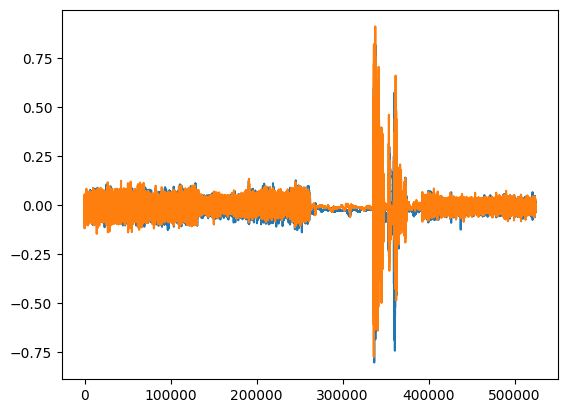

In [7]:
#@markdown How many audio clips to create
batch_size =  4#@param {type:"number"}

#@markdown Number of steps (100 is a good start, more steps trades off speed for quality)
steps = 100 #@param {type:"number"}

#@markdown Multiplier on the default sample length from the model, allows for longer audio clips at the expense of VRAM
sample_length_mult = 2#@param {type:"number"}

#@markdown Check the box below to skip this section when running all cells
skip_for_run_all = False #@param {type: "boolean"}

effective_length = sample_length_mult * args.sample_size

if not skip_for_run_all:
  torch.cuda.empty_cache()
  gc.collect()

  #generate random noise to sample from
  noise = torch.randn([batch_size, 2, effective_length]).to(device)

  generated = sample(model_fn, noise, steps, sampler_type)

  #clamp the generated audio
  generated = generated.clamp(-1, 1)

  #put all the audio files together
  generated_all = rearrange(generated, 'b d n -> d (b n)')

  print("All samples")
  #plot the audio (all the generated audio against the sample rate)
  plot_and_hear(generated_all, args.sample_rate)
  for ix, gen_sample in enumerate(generated):
    print(f'sample #{ix + 1}')
    #display the audio file for users to play in colab
    display(ipd.Audio(gen_sample.cpu(), rate=args.sample_rate))

else:
  print("Skipping section, uncheck 'skip_for_run_all' to enable")


# Regenerate your own sounds
By adding noise to an audio file and running it through the model to be denoised, new details will be created, pulling the audio closer to the "sonic space" of the model. The more noise you add, the more the sound will change.

The effect of this is a kind of "style transfer" on the audio. For those familiar with image generation models, this is analogous to an "init image".

  0%|          | 0/100 [00:00<?, ?it/s]

All samples


sample #1


sample #2


sample #3


sample #4


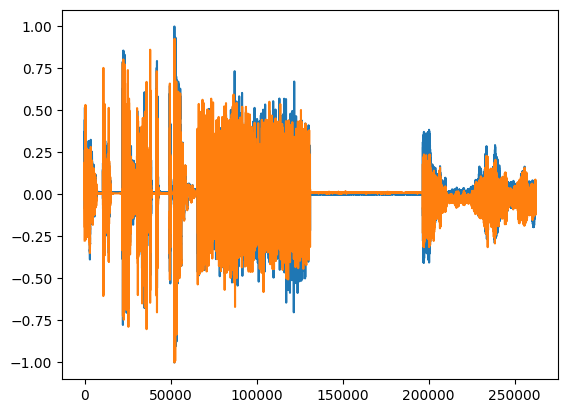

In [8]:
#@markdown How many audio clips to create
batch_size =  4#@param {type:"number"}

#@markdown Number of steps (100 is a good start, more steps trades off speed for quality)
steps = 100 #@param {type:"number"}

#@markdown Multiplier on the default sample length from the model, allows for longer audio clips at the expense of VRAM
sample_length_mult = 1#@param {type:"number"}

#@markdown Check the box below to skip this section when running all cells
skip_for_run_all = False #@param {type: "boolean"}

effective_length = sample_length_mult * args.sample_size

if not skip_for_run_all:
  torch.cuda.empty_cache()
  gc.collect()

  # Generate random noise to sample from
  noise = torch.randn([batch_size, 2, effective_length]).to(device)

  generated = sample(model_fn, noise, steps, sampler_type)

  # Hard-clip the generated audio
  generated = generated.clamp(-1, 1)

  # Put the demos together
  generated_all = rearrange(generated, 'b d n -> d (b n)')

  print("All samples")
  plot_and_hear(generated_all, args.sample_rate)
  for ix, gen_sample in enumerate(generated):
    print(f'sample #{ix + 1}')
    display(ipd.Audio(gen_sample.cpu(), rate=args.sample_rate))

else:
  print("Skipping section, uncheck 'skip_for_run_all' to enable")


In [ ]:
# n_mels=128
# hop_length=512
# sample_rate = 22050
# spectrogram = compute_mel_spectrogram(audio_sample_1d, sample_rate, n_mels, hop_length)
# plot_spectrogram(spectrogram, audio_sample_1d[1], hop_length, genre=None)

In [9]:
#@title Enter a filepath to a prerecorded audio file
import torch
import torchaudio
from typing import Iterable, Tuple
import gradio as gr

Audio = Tuple[int, np.ndarray]

#@markdown Enter a path to an audio file you want to alter, or leave blank to upload a file (.wav or .flac).
file_path = "/content/drive/MyDrive/dl4m/arrhythmia.wav" #@param{type:"string"}

#@markdown Number of audio recordings to combine into one clip. Only applies if the "record_audio" box is checked.
n_audio_recordings = 1 #@param{type:"number"}

#this is a global variable to be filled in by the generate_from_audio callback
recording_file_path = ""

def combine_audio(*audio_iterable: Iterable[Audio]) -> Audio:
    '''  
      combine the data of an audio signal into one using iterable
      ------
      Paramters:
        audio_iterable: iterable object
          the iterable version of the audio
    '''
    #combines an iterable of audio signals into one
    max_len = max([x.shape for _, x in audio_iterable])
    combined_audio = np.zeros(max_len, dtype=np.int32)
    for _, a in audio_iterable:
        combined_audio[:a.shape[0]] = combined_audio[:a.shape[0]] * .5 + a * .5
    return combined_audio


def generate_from_audio(file_path: str, *audio_iterable: Iterable[Audio]):
    '''  
      generate audio
      ------
      Paramters:
        file_path: str
          the file path
        audio_iterable: iterable object
          the iterable version of the audio
    '''
    #generates the audio
    sample_rate = audio_iterable[0][0]
    #combining the audio
    combined_audio = combine_audio(*audio_iterable)
    #creating tensor and reshaping the combined audio file
    tensor = torch.from_numpy(
        np.concatenate(
            [
                combined_audio.reshape(1, -1),
                combined_audio.reshape(1, -1)
            ],
            axis=0,
        )
    )
    global recording_file_path
    recording_file_path = file_path

    #using torchaudio to save the combined audio as a wav file using the tensor + sample rate
    torchaudio.save(
        file_path,
        tensor,
        sample_rate=sample_rate,
        format="wav"
    )

    return (sample_rate, combined_audio), file_path

# Interpolate between sounds
Diffusion models allow for interpolation between inputs through a process of deterministic noising and denoising. 

By deterministically noising two audio files, interpolating between the results, and deterministically denoising them, we can can create new sounds "between" the audio files provided.

Source audio sample loaded
Target audio sample loaded
Initial audio samples


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Full interpolation


sample #1


sample #2


sample #3


sample #4


sample #5


sample #6


sample #7


sample #8


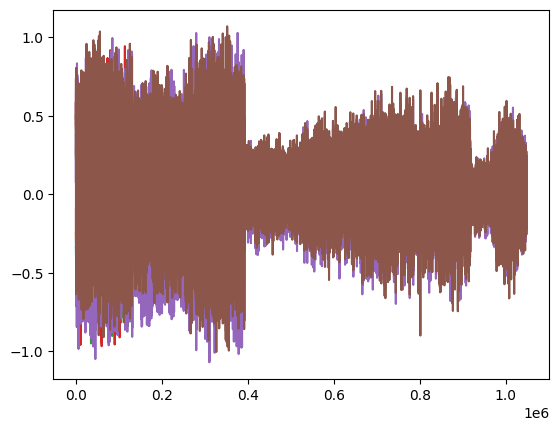

In [11]:
#interpolation code taken and modified from CRASH
def compute_interpolation_in_latent(latent1, latent2, lambd):
    '''
    Implementation of Spherical Linear Interpolation: https://en.wikipedia.org/wiki/Slerp
    latent1: tensor of shape (2, n)
    latent2: tensor of shape (2, n)
    lambd: list of floats between 0 and 1 representing the parameter t of the Slerp
    '''
    device = latent1.device
    lambd = torch.tensor(lambd)

    assert(latent1.shape[0] == latent2.shape[0])

    #get the number of channels
    nc = latent1.shape[0]
    interps = []
    for channel in range(nc):
    
      cos_omega = latent1[channel]@latent2[channel] / \
          (torch.linalg.norm(latent1[channel])*torch.linalg.norm(latent2[channel]))
      omega = torch.arccos(cos_omega).item()

      a = torch.sin((1-lambd)*omega) / np.sin(omega)
      b = torch.sin(lambd*omega) / np.sin(omega)
      a = a.unsqueeze(1).to(device)
      b = b.unsqueeze(1).to(device)
      interps.append(a * latent1[channel] + b * latent2[channel])
    return rearrange(torch.cat(interps), "(c b) n -> b c n", c=nc) 


#inserting markdown to create interface for user to choose their own parameters
#@markdown Enter the paths to two audio files to interpolate between (.wav or .flac)
source_audio_path = "/content/drive/MyDrive/dl4m/arrhythmia.wav" #@param{type:"string"}
target_audio_path = "/content/drive/MyDrive/dl4m/storm.wav" #@param{type:"string"}

#@markdown Total number of steps (100 is a good start, can go lower for more speed/less quality)
steps = 100#@param {type:"number"}

#@markdown Number of interpolated samples
n_interps = 6 #@param {type:"number"}

#@markdown Multiplier on the default sample length from the model, allows for longer audio clips at the expense of VRAM
sample_length_mult = 2#@param {type:"number"}

#@markdown Check the box below to skip this section when running all cells
skip_for_run_all = False #@param {type: "boolean"}

effective_length = args.sample_size * sample_length_mult

if not skip_for_run_all:

  #creating sequential neural network if user didn't choose skip_for_run_all
  augs = torch.nn.Sequential(
    PadCrop(effective_length, randomize=True),
    Stereo()
  )

  #throw an error if user didn't provide file path for source audio
  if source_audio_path == "":
    print("No file path provided for the source audio, please upload a file")
    uploaded = files.upload()
    source_audio_path = list(uploaded.keys())[0]

  #allow user to download the audio to their local device
  audio_sample_1 = load_to_device(source_audio_path, args.sample_rate)

  print("Source audio sample loaded")

  #throw an error if user didn't provide file path for target audio
  if target_audio_path == "":
    print("No file path provided for the target audio, please upload a file")
    uploaded = files.upload()
    target_audio_path = list(uploaded.keys())[0]

  audio_sample_2 = load_to_device(target_audio_path, args.sample_rate)

  print("Target audio sample loaded")

  #create array of audio samples
  audio_samples = augs(audio_sample_1).unsqueeze(0).repeat([2, 1, 1])
  audio_samples[1] = augs(audio_sample_2)

  print("Initial audio samples")
  plot_and_hear(audio_samples[0], args.sample_rate)
  plot_and_hear(audio_samples[1], args.sample_rate)

  #reversing the sample
  reversed = reverse_sample(model_fn, audio_samples, steps)

  #creating a interpolation between the two provided tensors given a timestep and returning the interpolated tensor
  latent_series = compute_interpolation_in_latent(reversed[0], reversed[1], [k/n_interps for k in range(n_interps + 2)])

  #creating audio sample based on model
  generated = sample(model_fn, latent_series, steps) 

  #put all the interpolations together
  generated_all = rearrange(generated, 'b d n -> d (b n)')

  print("Full interpolation")
  #plots the interpolation sample
  plot_and_hear(generated_all, args.sample_rate)
  for ix, gen_sample in enumerate(generated):
    print(f'sample #{ix + 1}')
    display(ipd.Audio(gen_sample.cpu(), rate=args.sample_rate))
else:
  print("Skipping section, uncheck 'skip_for_run_all' to enable") 